DeepFace (Keras) doesn't work with the current conda environment. The parser ueses DeepFace, same as the one from previous semester's face similarity parser. Please load the conda environment related to previous semester's face similarity parser. The face similarity ipynb file has also been added to a separate file for convenience

In [1]:
# Import for both DeepFace & Autoencoder
import os
import subprocess
from tqdm import tqdm
import glob
import argparse
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from PIL import Image

In [2]:
# Import for DeepFace
from deepface import DeepFace

ImportError: cannot import name 'deserialize_keras_object' from partially initialized module 'keras.saving.legacy.serialization' (most likely due to a circular import) (/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/keras/saving/legacy/serialization.py)

In [2]:
# CHANGE THIS DIRECTORY TO WHERE TEXTURES ARE
#candidate_directory = '/projectnb/sparkgrp/ml-atfal-mafkoda-grp/candidate_repository/'
candidate_directory = '/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/'
# CHANGE THIS DIRECTORY TO NEW SET OF IMAGES FOR STRUCTURE
image_directory = '/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/'
# CHANGE THIS TO OUTPUT FILE NAME FOR DEEPFACE MODEL
output_file_name = 'google-trial.csv'

output_dir = "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/simonkye/google-trial.csv"
# CHANGE THIS TO OUTPUT FILE NAME FOR PARSED DEEPFACE MODEL OUTPUT
parsed_output_file_name = 'google-parsed_trial.csv'

In [4]:
directory = '/projectnb/sparkgrp/ml-atfal-mafkoda-grp/candidate_repository'
file_list = os.listdir(directory)

for file_name in file_list:
    if file_name.endswith('.pkl'):
        os.remove(os.path.join(directory, file_name))

In [5]:

class FaceRecognition:
    def __init__(self, missing_dir, unknown_dir, output_path, model='VGG-Face', metric='euclidean_l2', detector_backend='mtcnn'):
        # Initialize the FaceRecognition class with directories, output path, model, metric, and detector backend
        self.missing_dir = missing_dir  # Directory of missing persons' images
        self.unknown_dir = unknown_dir  # Directory of unknown persons' images
        self.output_path = output_path  # Path for the output CSV file
        self.model = model  # Face recognition model
        self.metric = metric  # Distance metric for comparison
        self.detector_backend = detector_backend  # Backend for face detection
        # self.metric_col = self.model + "_" + self.metric  # Column name for metric in the output DataFrame

    def detect_and_match_faces(self):
        # Detect and match faces in images from the missing directory
        image_paths = glob.glob(os.path.join(self.missing_dir, "*"))  # Get all image paths
        results = []  # List to store the results
        for path in image_paths:
            # Check the file extension
            ext = os.path.splitext(path)[1].lower()
            if ext in [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"]:
                # Extract faces from the image
                detected_img_objs = DeepFace.extract_faces(path, enforce_detection=False, detector_backend=self.detector_backend)
                
                if detected_img_objs:
                    # Find matches in the unknown directory using DeepFace
                    dfs_list = DeepFace.find(
                        img_path=path,
                        db_path=self.unknown_dir, 
                        model_name=self.model,
                        distance_metric=self.metric,
                        enforce_detection=False,
                        detector_backend=self.detector_backend
                    )

                    dfs = dfs_list[0]

                    
                    dfs['identity'] = dfs['identity'].str.split('/').str.get(-1)
                    print(dfs.head())

                    # Check if the DataFrame is not empty and append the results
                    if not dfs.empty:
                        matched_filenames = ', '.join(dfs['identity'].tolist())
                        print(matched_filenames)
                        # metric_values = ', '.join(map(str, dfs[self.metric_col].tolist()))

                        results.append({
                            'missing_filename': path,
                            'unknowns_matched_filenames': matched_filenames,
                            'distance': dfs['distance']
                        })

        df = pd.DataFrame(results)  # Create DataFrame from results
        df.to_csv(self.output_path, index=False)  # Save the results to a CSV file

def parse_args():
    # Define command line arguments for the script
    parser = argparse.ArgumentParser(description='Face recognition')
    parser.add_argument('--model', type=str, default='VGG-Face', help='Model to use for Face Recognition')
    parser.add_argument('--metric', type=str, default='euclidean_l2', help='Metrics to use for Face Recognition')
    parser.add_argument('--missing_dir', required=True, type=str, help='Directory containing images of missing persons')
    parser.add_argument('--unknown_dir', required=True, type=str, help='Directory containing images of unknown persons')
    parser.add_argument('--output_path', required=True, type=str, help='Path to the output CSV file')
    parser.add_argument('--detector_backend', type=str, default='mtcnn', help='Detector backend to use')
    return parser.parse_args()

if __name__ == '__main__':
    fr = FaceRecognition(
        missing_dir=image_directory,
        unknown_dir=candidate_directory,
        output_path=output_file_name
    )
    fr.detect_and_match_faces()


1/1 [==============================] - 0s 219ms/step
24-04-21 21:52:14 - Searching /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_366.png in 13 length datastore
1/1 [==============================] - 0s 14ms/step
24-04-21 21:52:14 - find function duration 1.582688570022583 seconds
Empty DataFrame
Columns: [identity, hash, target_x, target_y, target_w, target_h, source_x, source_y, source_w, source_h, threshold, distance]
Index: []
1/1 [==============================] - 0s 16ms/step
24-04-21 21:52:15 - Searching /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_53.png in 13 length datastore
1/1 [==============================] - 0s 14ms/step
24-04-21 21:52:16 - find function duration 0.5125904083251953 seconds
Empty DataFrame
Columns: [identity, hash, target_x, target_y, target_w, target_h, source_x, source_y, source_w, source_h, threshold, distance]
Index: []
1/1 [

# (After DeepFace Face Similarity)
The code block assumes you have the outputs from FaceSimilarity. It finds the closest result that isn't itself. (that's why the < 0.001 check exists) It will use the most similar looking image from the image repository as the structure and the candidate repository as the texture.

The following code block exists as the DeepFace model keeps checkpoints in its model leading it to match faces that no longer exist in the candidate_directory or the image_directory. This is why the -checkpoint check exists, so do not name any input file with the string '-checkpoint'

In [3]:
df = pd.read_csv(output_dir)

for index, row in df.iterrows():
    row['unknowns_matched_filenames'] = row['unknowns_matched_filenames'].split(', ')
    row['missing_filename'] = row['missing_filename'].split('/')[-1]
    
    # Convert the 'distance' column to a list
    data = row['distance']
    datapoints = data.split()
    df.loc[index, 'valid_found'] = False
    best_match = None

    for i in range(len(datapoints)):
        try:
            if float(datapoints[i]) < 0.001:
                continue
            filename = row['unknowns_matched_filenames'][i - 1]
            if '-checkpoint' not in filename:
                best_match = filename
                df.loc[index, 'valid_found'] = True
                break
        except ValueError:
            break

    if best_match is None:
        df.loc[index, 'best_match'] = row['missing_filename']
    else:
        df.loc[index, 'best_match'] = best_match
        
df.to_csv(parsed_output_file_name, index=False)

# Without DeepFace Similarity
The code block below assumes a manually made csv is being used. The only columns needed is 'missing_filename' (structure image file name), 'valid_found' (set to True), and best_match (texture image file name)

In [ ]:
df = pd.read_csv(output_dir)

# Auto Swapping Encoder
The code block is simply running the python commands needed to run the model as it only uses Python files rather than ipynb files. Therefore, if a user wanted to run the model without generating a csv, they can cd to the swapping-autoencoder-pytorch directory and run the following command.

`python -m experiments ffhq512_pretrained test simple_interpolation --input_structure_image [full path to structure image] --input_texture_image [full path to texture image]`

In [4]:
os.chdir("/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch")
for index, row in tqdm(df.iterrows(), total=len(df)):
    
    missing_filename = row['missing_filename'] 
    input_structure_image = image_directory + missing_filename
    directory_exists = os.path.exists(os.path.dirname(input_structure_image))
    best_match_filename = row['best_match']
    input_texture_image = candidate_directory + best_match_filename
    directory_exists = os.path.exists(os.path.dirname(input_texture_image)) and directory_exists
    if not directory_exists:
        print("invalid directory")
    if not row['valid_found']:
        print("no valid image found for " + missing_filename)
    else:
        command = [
            "python",
            "-m",
            "experiments",
            "ffhq512_pretrained",
            "test",
            "simple_interpolation",
            "--input_structure_image",
            input_structure_image,
            "--input_texture_image",
            input_texture_image
        ]
        
        try:
            subprocess.run(command, check=True)
        except subprocess.CalledProcessError as e:
            print(f"Error executing command: {e}")

  0%|          | 0/51 [00:00<?, ?it/s]/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

  2%|▏         | 1/51 [00:07<06:08,  7.37s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_298.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

  4%|▍         | 2/51 [00:12<04:43,  5.79s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_705.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

  6%|▌         | 3/51 [00:16<04:08,  5.17s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_65.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

  8%|▊         | 4/51 [00:21<03:51,  4.92s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_107.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 10%|▉         | 5/51 [00:25<03:38,  4.76s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_696.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 12%|█▏        | 6/51 [00:30<03:34,  4.76s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_562.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 14%|█▎        | 7/51 [00:34<03:24,  4.65s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_202.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 16%|█▌        | 8/51 [00:39<03:19,  4.65s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_571.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 18%|█▊        | 9/51 [00:43<03:07,  4.46s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 20%|█▉        | 10/51 [00:48<03:05,  4.52s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_398.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 22%|██▏       | 11/51 [00:52<02:59,  4.49s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_62.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 24%|██▎       | 12/51 [00:56<02:51,  4.41s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_125.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_8.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 25%|██▌       | 13/51 [01:01<02:49,  4.45s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_517.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 27%|██▋       | 14/51 [01:06<02:48,  4.56s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_471.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 29%|██▉       | 15/51 [01:11<02:50,  4.74s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_73.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 31%|███▏      | 16/51 [01:16<02:51,  4.89s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_683.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 33%|███▎      | 17/51 [01:20<02:41,  4.76s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_14.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 35%|███▌      | 18/51 [01:25<02:36,  4.75s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_8.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 37%|███▋      | 19/51 [01:30<02:29,  4.68s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_251.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 39%|███▉      | 20/51 [01:34<02:26,  4.71s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_369.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 41%|████      | 21/51 [01:39<02:19,  4.66s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_140.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_9.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 43%|████▎     | 22/51 [01:43<02:13,  4.61s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_333.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 45%|████▌     | 23/51 [01:48<02:09,  4.62s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_420.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 47%|████▋     | 24/51 [01:53<02:04,  4.60s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_740.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 49%|████▉     | 25/51 [01:57<01:57,  4.54s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_443.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 51%|█████     | 26/51 [02:01<01:52,  4.51s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_647.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 53%|█████▎    | 27/51 [02:07<01:52,  4.68s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_25.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_11.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 55%|█████▍    | 28/51 [02:12<01:50,  4.79s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_301.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 57%|█████▋    | 29/51 [02:16<01:43,  4.72s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_754.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_2.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 59%|█████▉    | 30/51 [02:21<01:36,  4.62s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_392.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 61%|██████    | 31/51 [02:25<01:30,  4.54s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_776.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 63%|██████▎   | 32/51 [02:30<01:27,  4.58s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_211.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 65%|██████▍   | 33/51 [02:34<01:21,  4.53s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_84.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_2.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 67%|██████▋   | 34/51 [02:39<01:17,  4.53s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_500.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_9.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 69%|██████▊   | 35/51 [02:43<01:13,  4.59s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_36.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 71%|███████   | 36/51 [02:48<01:07,  4.51s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_491.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 73%|███████▎  | 37/51 [02:52<01:02,  4.45s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_145.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 75%|███████▍  | 38/51 [02:56<00:58,  4.48s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_403.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 76%|███████▋  | 39/51 [03:01<00:54,  4.54s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_676.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 78%|███████▊  | 40/51 [03:06<00:49,  4.53s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_749.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 80%|████████  | 41/51 [03:10<00:46,  4.60s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_367.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 82%|████████▏ | 42/51 [03:15<00:42,  4.73s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_494.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 84%|████████▍ | 43/51 [03:20<00:38,  4.81s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_365.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 86%|████████▋ | 44/51 [03:25<00:32,  4.67s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_230.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 88%|████████▊ | 45/51 [03:30<00:28,  4.69s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_592.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 90%|█████████ | 46/51 [03:34<00:23,  4.68s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_726.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_12.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 92%|█████████▏| 47/51 [03:39<00:18,  4.62s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_22.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 94%|█████████▍| 48/51 [03:43<00:13,  4.56s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_701.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_12.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 96%|█████████▌| 49/51 [03:48<00:09,  4.60s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_70.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_1.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

 98%|█████████▊| 50/51 [03:52<00:04,  4.54s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_458.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building 

ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

100%|██████████| 51/51 [03:57<00:00,  4.65s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_124.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


0it [00:00, ?it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_298.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


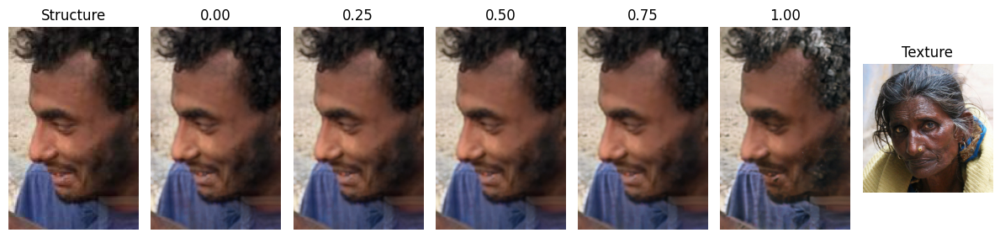

1it [00:00,  2.23it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_705.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png


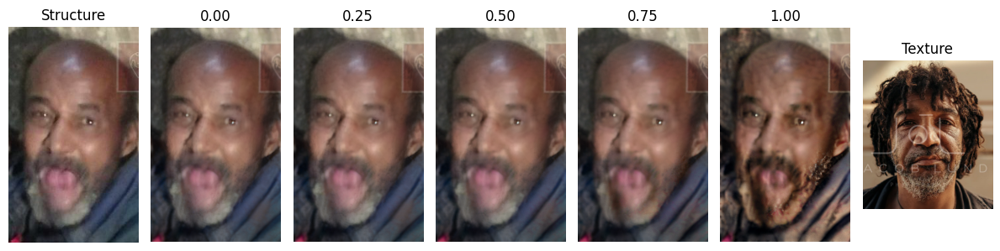

2it [00:00,  2.17it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_65.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


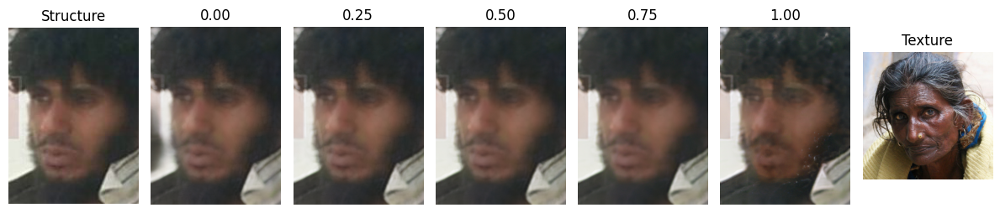

3it [00:01,  2.24it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_107.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png


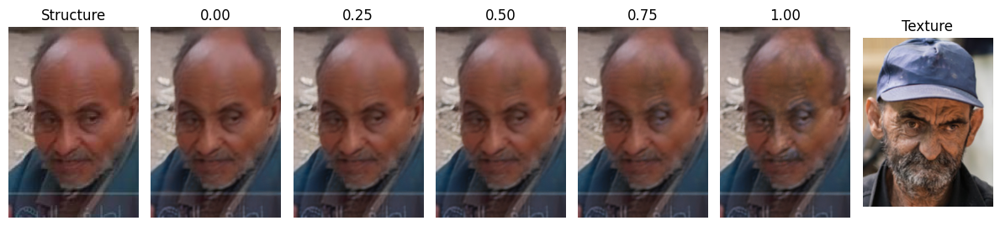

4it [00:01,  2.27it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_696.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


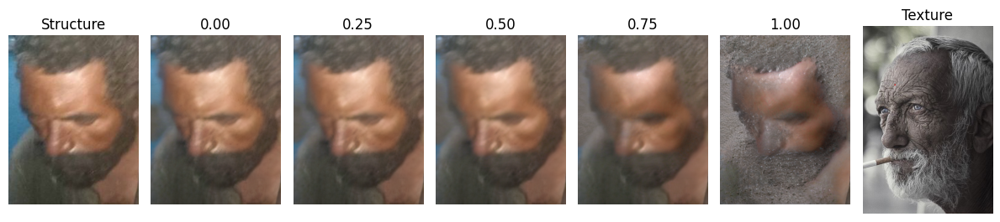

5it [00:02,  2.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_562.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


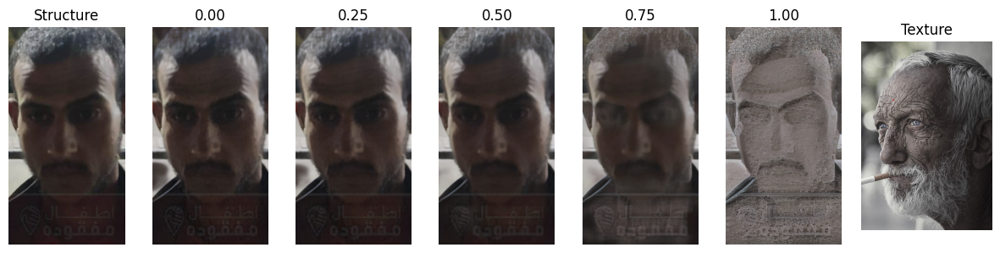

6it [00:02,  2.30it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_202.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png


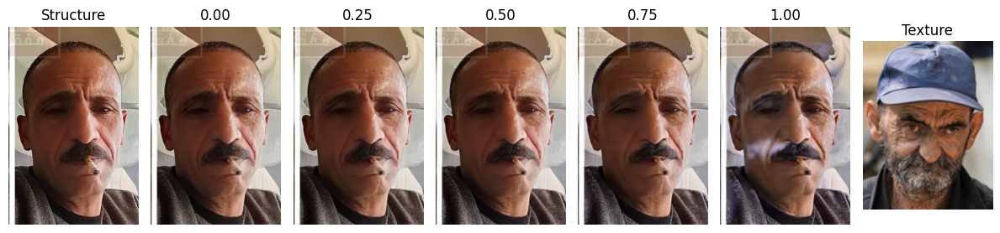

7it [00:03,  2.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_571.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


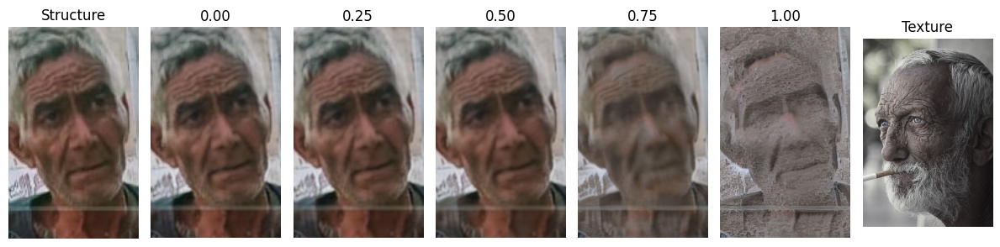

8it [00:03,  2.18it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


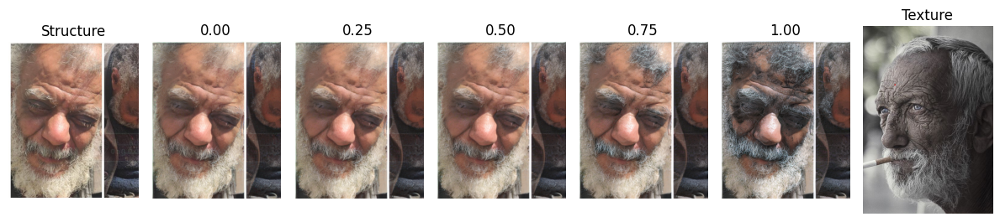

9it [00:03,  2.31it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_398.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png


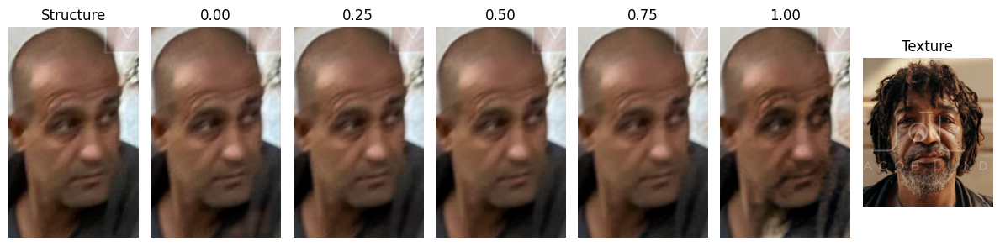

10it [00:04,  2.27it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_62.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


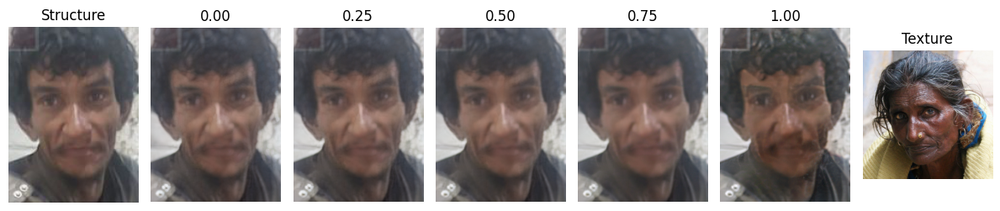

11it [00:04,  2.24it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_125.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_8.png


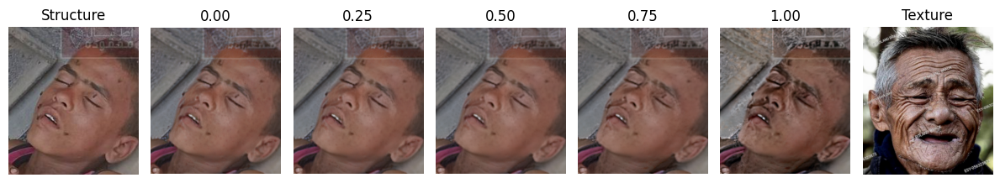

12it [00:05,  2.38it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_517.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


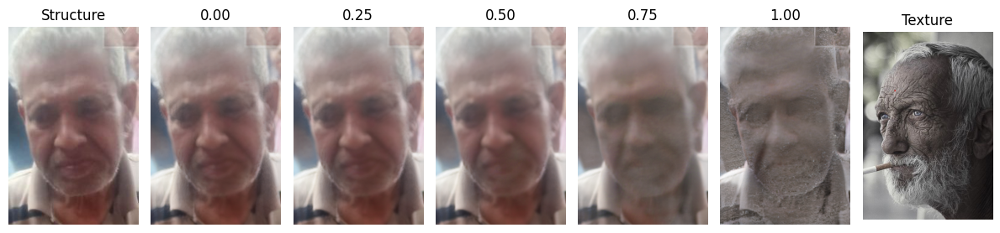

13it [00:05,  2.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_471.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png


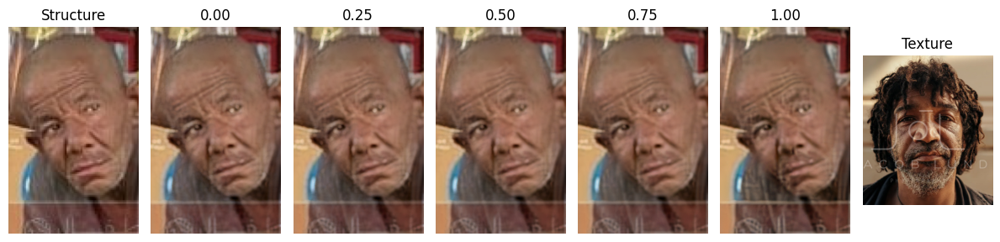

14it [00:06,  2.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_73.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


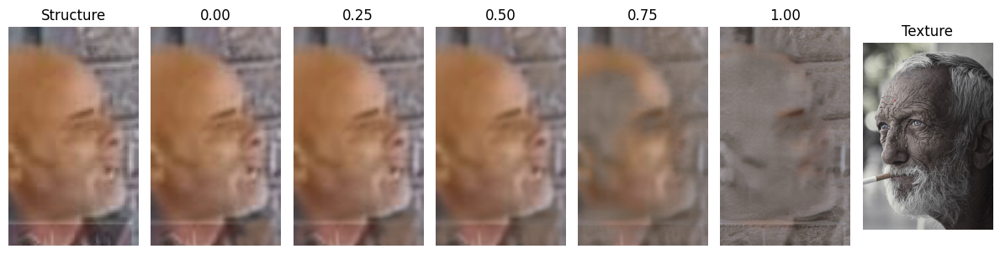

15it [00:06,  2.19it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_683.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


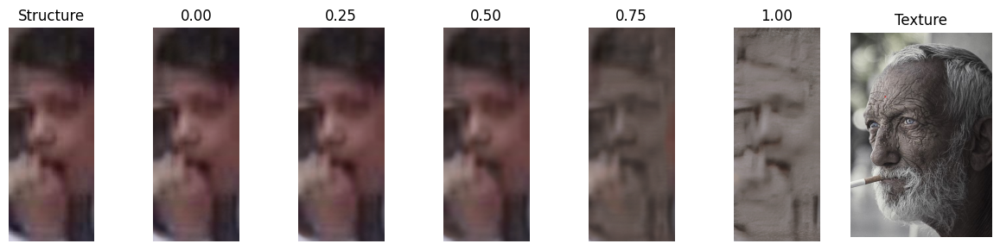

16it [00:07,  2.17it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_14.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


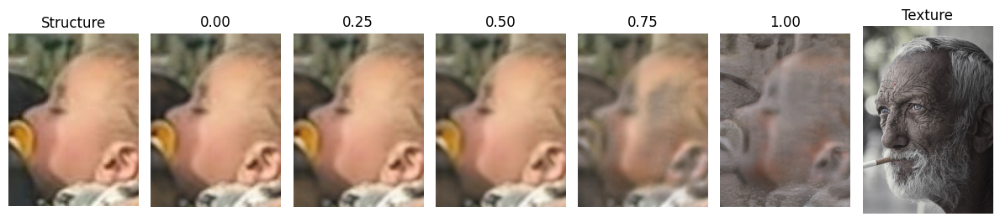

17it [00:07,  2.25it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_8.png


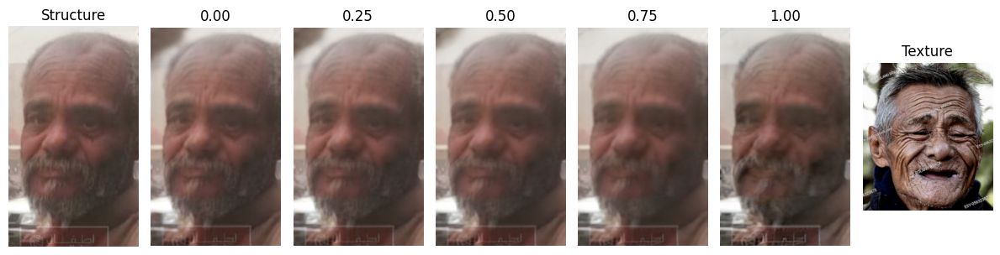

18it [00:07,  2.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_251.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


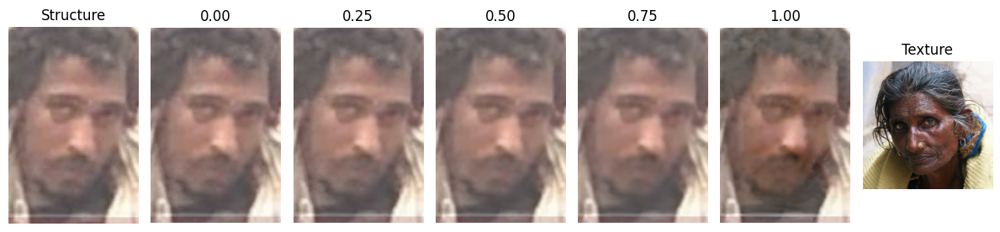

19it [00:08,  2.17it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_369.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


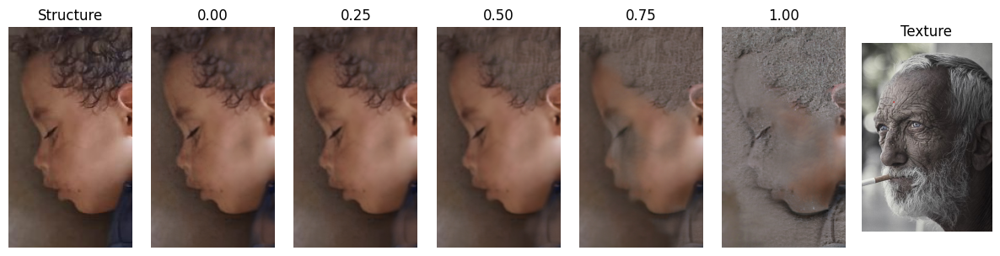

20it [00:08,  2.18it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_140.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_9.png


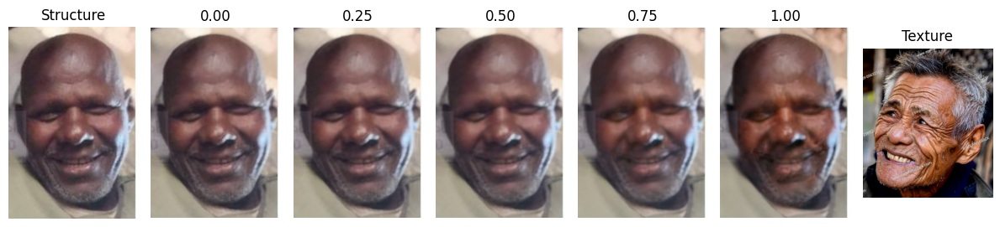

21it [00:09,  2.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_333.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png


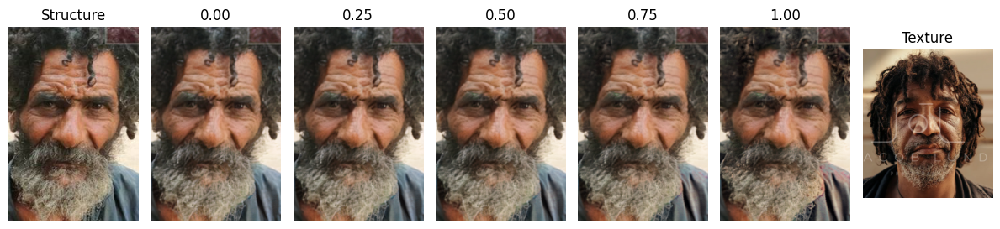

22it [00:09,  2.26it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_420.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png


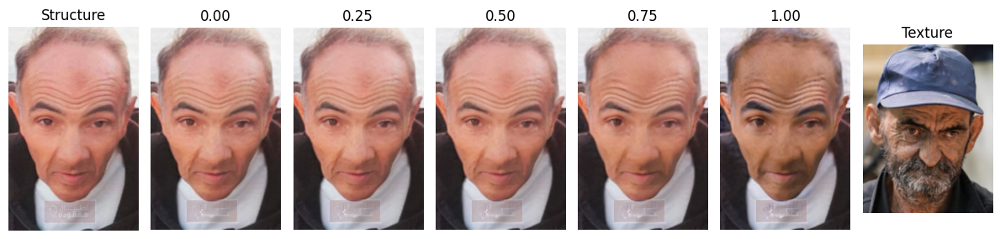

23it [00:10,  2.14it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_740.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


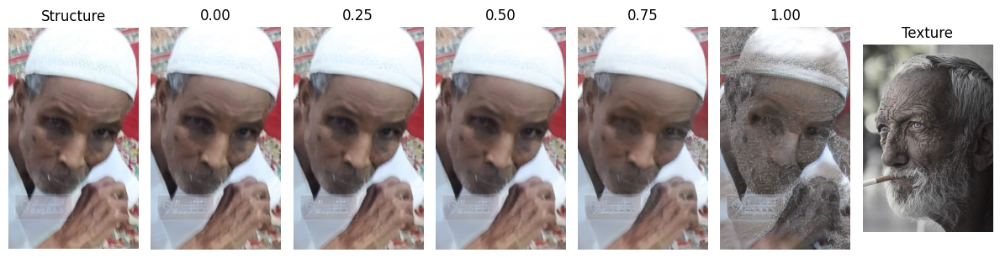

24it [00:10,  2.11it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_443.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


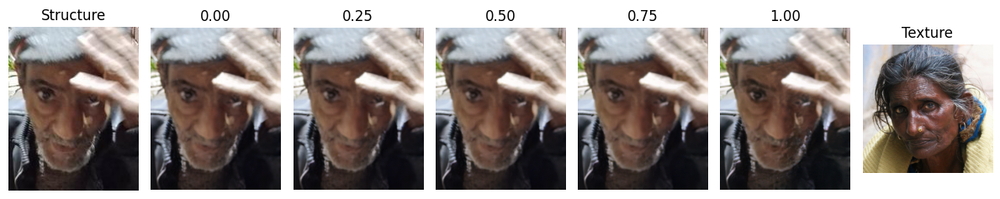

25it [00:11,  2.28it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_647.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


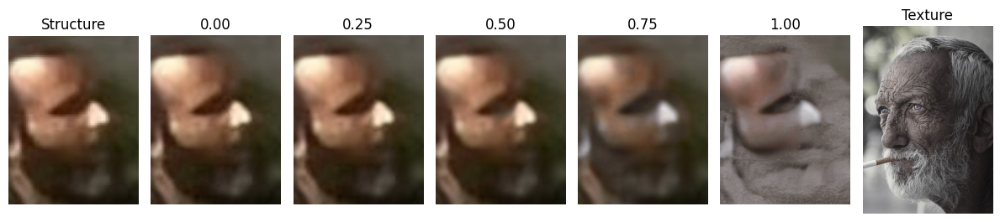

26it [00:11,  2.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_25.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_11.png


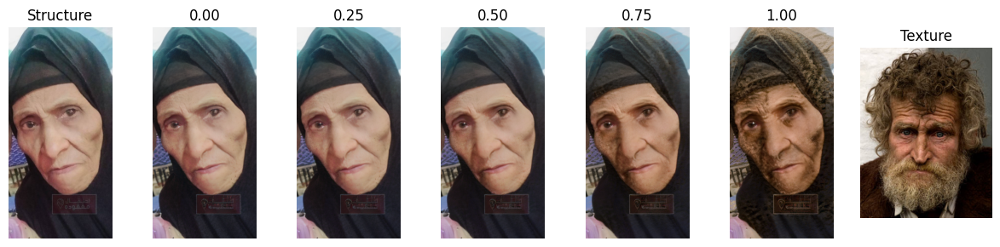

27it [00:12,  2.18it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_301.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


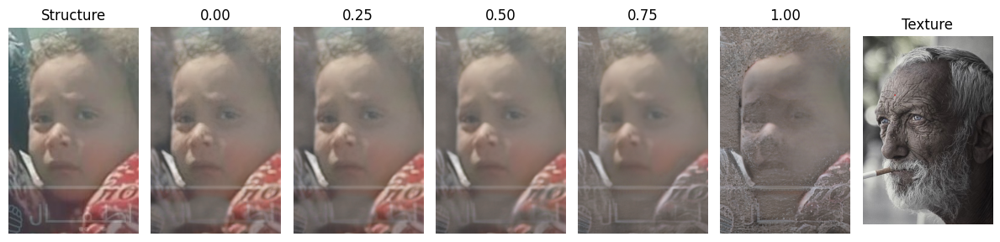

28it [00:12,  2.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_754.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_2.png


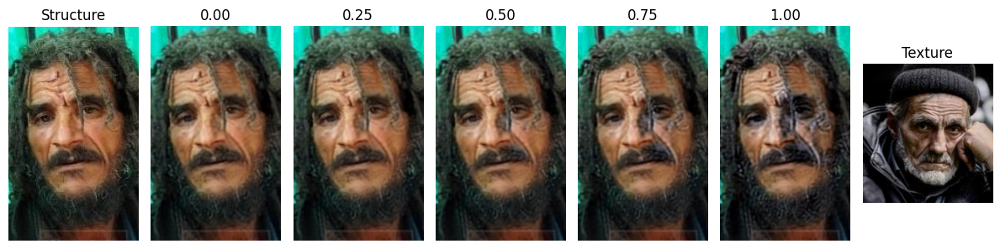

29it [00:12,  2.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_392.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


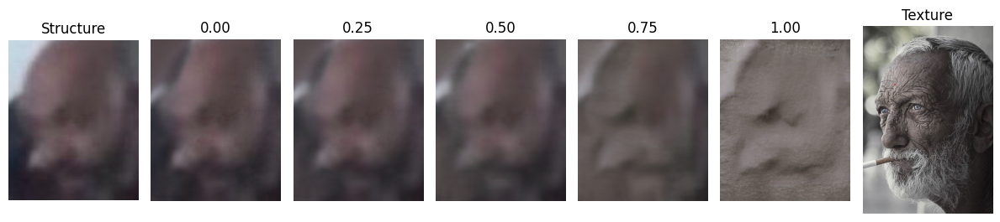

30it [00:13,  2.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_776.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


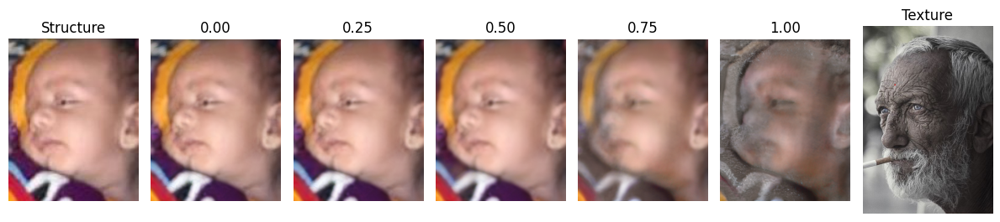

31it [00:13,  2.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_211.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


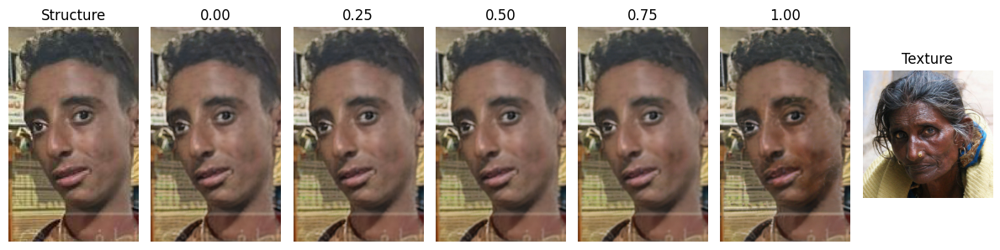

32it [00:14,  2.29it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_84.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_2.png


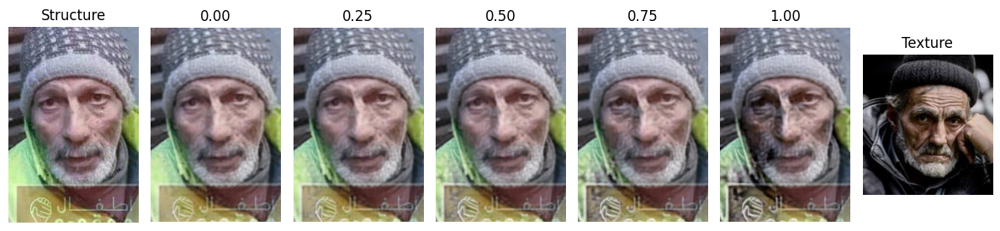

33it [00:14,  2.32it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_500.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_9.png


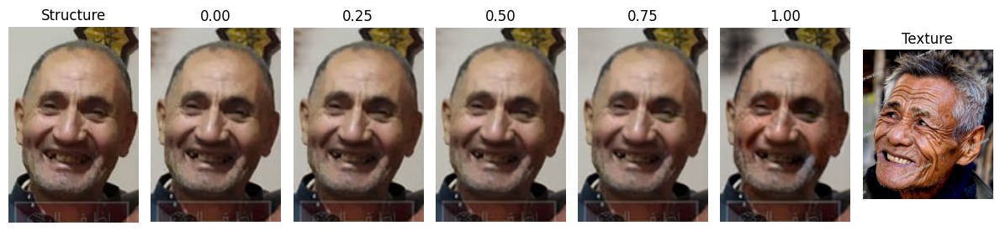

34it [00:15,  2.32it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_36.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


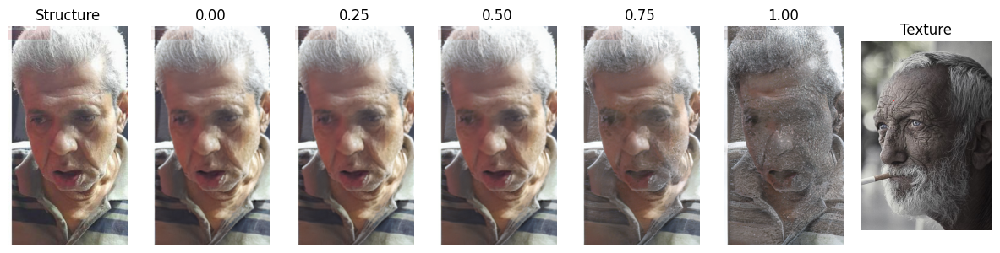

35it [00:15,  2.20it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_491.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


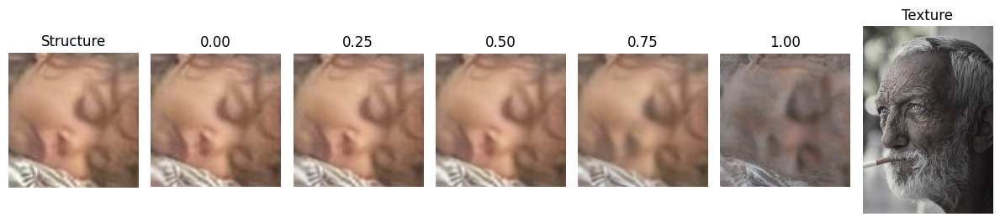

36it [00:15,  2.39it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_145.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


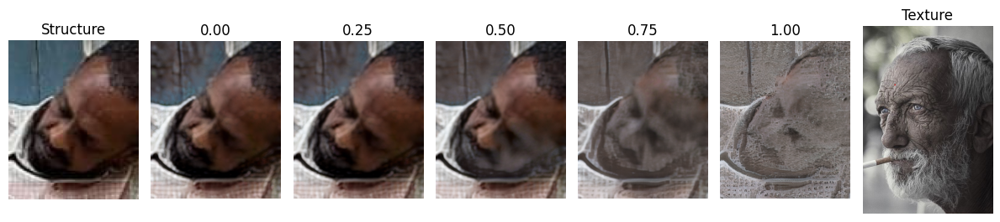

37it [00:16,  2.48it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_403.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


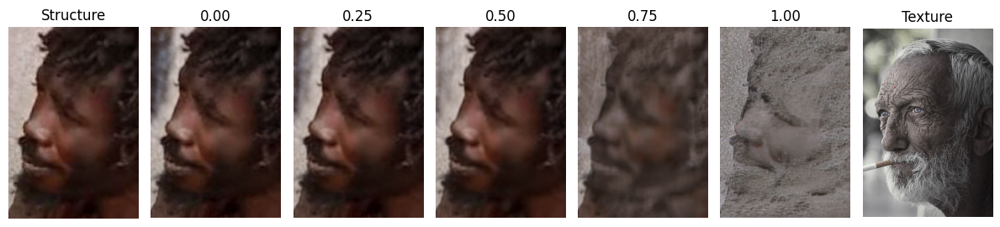

38it [00:16,  2.43it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_676.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png


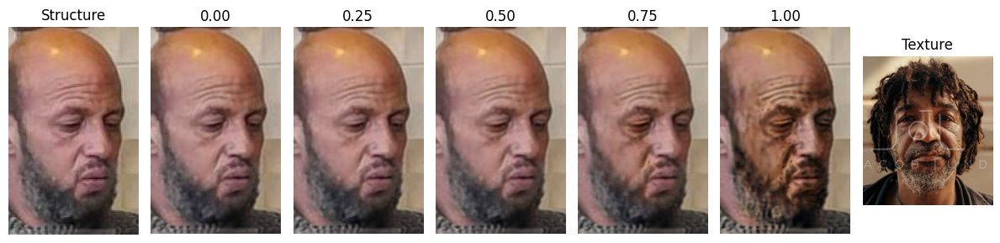

39it [00:17,  2.30it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_749.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png


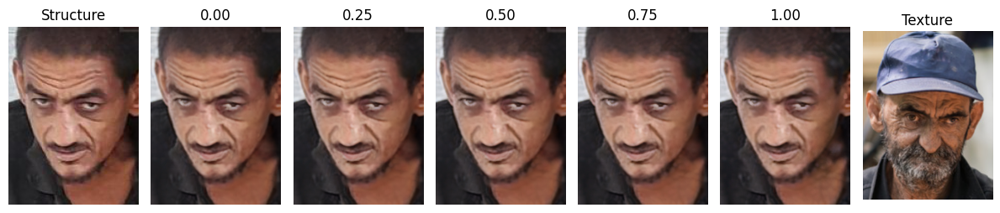

40it [00:17,  2.38it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_367.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


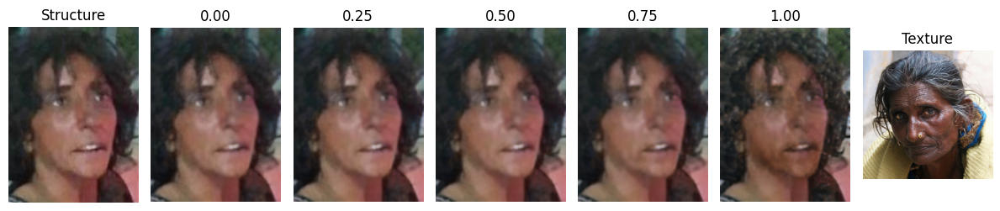

41it [00:17,  2.42it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_494.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png


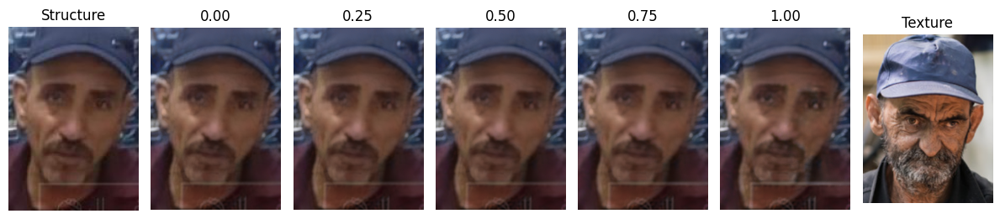

42it [00:18,  2.44it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_365.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_13.png


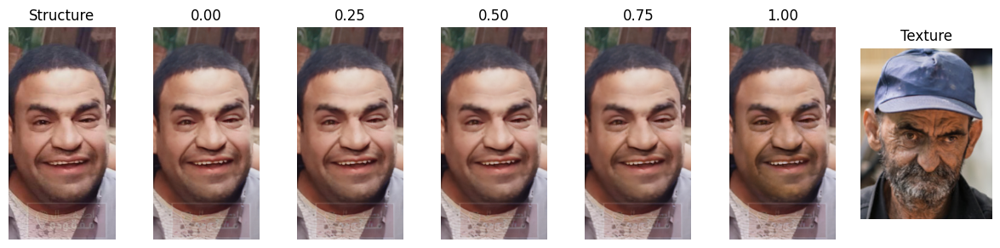

43it [00:18,  2.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_230.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_10.png


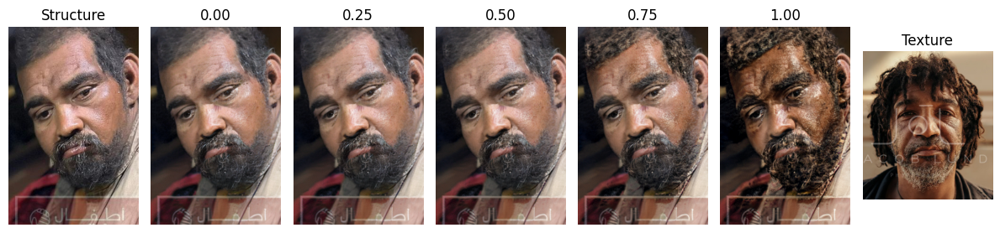

44it [00:19,  2.23it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_592.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


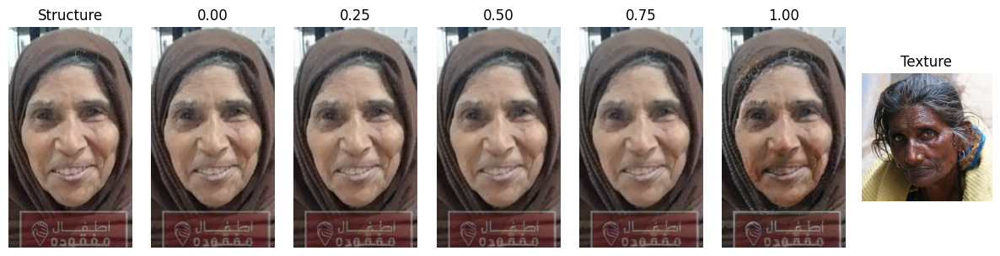

45it [00:19,  2.24it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_726.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_12.png


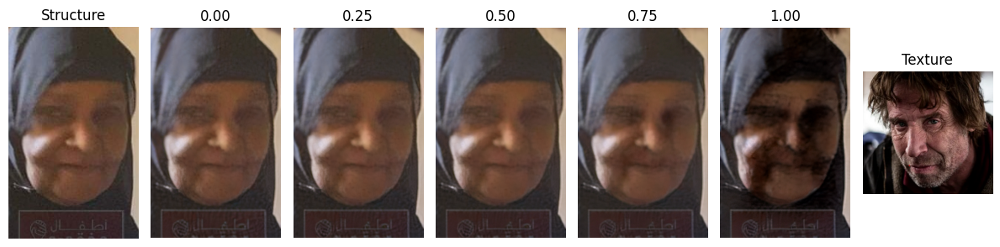

46it [00:20,  2.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_22.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


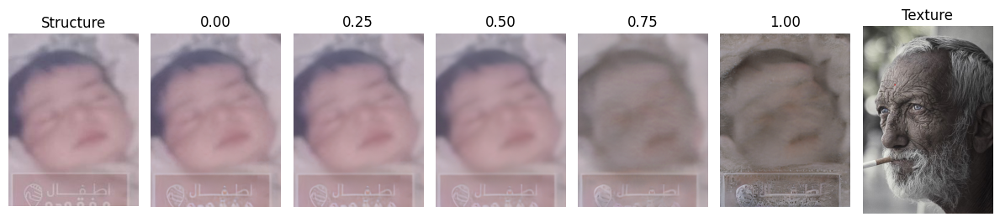

47it [00:20,  2.29it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_701.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_12.png


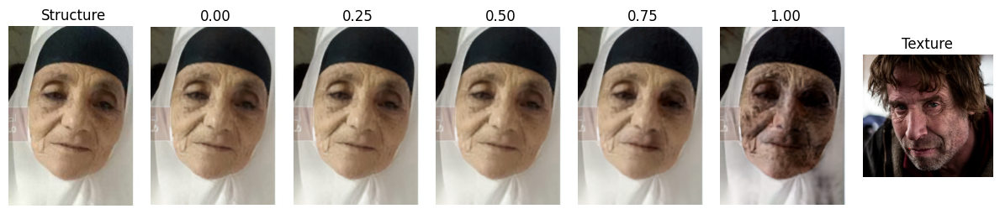

48it [00:21,  2.28it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_70.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_1.png


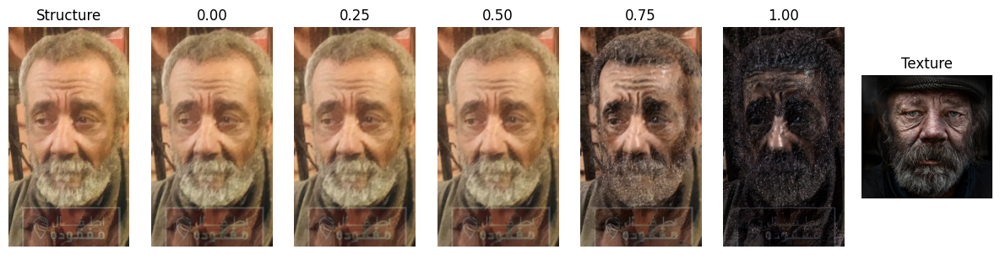

49it [00:21,  2.26it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_458.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_5.png


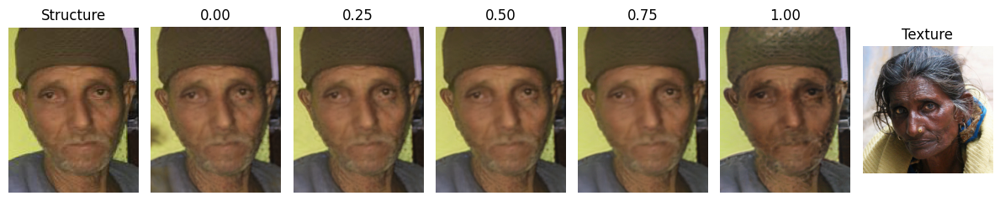

50it [00:21,  2.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_124.png
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/google_candidate/google_candidate_7.png


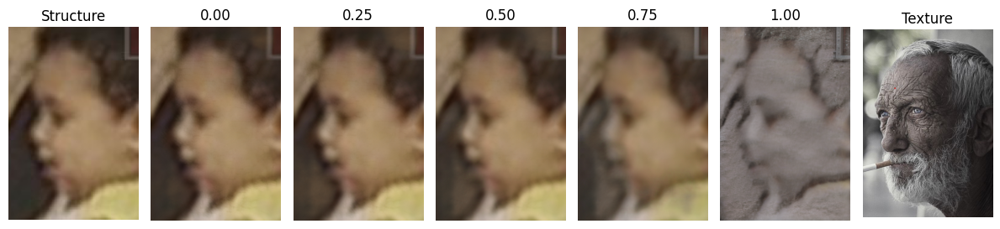

51it [00:22,  2.28it/s]

Missing Structures: 0
Missing Textures: 0
Missing Results: 0


In [6]:
missing_structure = 0
missing_texture = 0
missing_results = 0
def display_images(image_folder, image_prefix, image_suffix, input_structure_image, input_texture_image):
    global missing_structure, missing_texture, missing_results
    # Create a figure and grid layout
    fig = plt.figure(figsize=(12, 3))
    gs = gridspec.GridSpec(1, 7)  # 1 row, 7 columns

    # Display the input_structure_image
    try: 
        ax1 = plt.subplot(gs[0, 0])
        ax1.imshow(Image.open(input_structure_image))
        ax1.axis('off')
        ax1.set_title('Structure')
    except:
        print(f"File not found: {input_structure_image}")
        missing_structure += 1

    # Display the interpolated images
    try:
        for i in range(5):
            image_path = os.path.join(image_folder, f"{image_prefix}_{image_suffix}_{i*0.25:.2f}.png")
            ax = plt.subplot(gs[0, i+1])
            ax.imshow(Image.open(image_path))
            ax.axis('off')
            ax.set_title(f"{i*0.25:.2f}")
    except:
        print(f"File not found: {image_prefix}_{image_suffix}_{i*0.25:.2f}.png")
        missing_texture += 1

    # Display the input_texture_image
    try:
        ax7 = plt.subplot(gs[0, 6])
        ax7.imshow(Image.open(input_texture_image))
        ax7.axis('off')
        ax7.set_title('Texture')
    except:
        print(f"File not found: {input_texture_image}")
        missing_results += 1
    
    plt.tight_layout()
    plt.show()

for index, row in tqdm(df.iterrows()):
    if not row['valid_found']:
        continue
    missing_filename = row['missing_filename'] 
    input_structure_image = image_directory + missing_filename
    directory_exists = os.path.exists(os.path.dirname(input_structure_image))
    best_match_filename = row['best_match']
    input_texture_image = candidate_directory + best_match_filename
    print(input_structure_image)
    print(input_texture_image)
    directory_exists = os.path.exists(os.path.dirname(input_texture_image)) and directory_exists
    if not directory_exists or not row['valid_found']:
        print("Missing person's file not found or no valid candidate image found!")
    else:
        image_folder = "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/results/ffhq512_pretrained/simpleswapping/"
        image_prefix = row['missing_filename'].replace('.png', '')
        image_suffix = row['best_match'].replace('.png', '')
        input_structure_image = input_structure_image
        input_texture_image = input_texture_image
        
        display_images(image_folder, image_prefix, image_suffix, input_structure_image, input_texture_image)

print(f"Missing Structures: {missing_structure}")
print(f"Missing Textures: {missing_texture}")
print(f"Missing Results: {missing_results}")